<a href="https://colab.research.google.com/github/s434/google-colab-projects/blob/main/Object_Detection/Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#clone YOLOv5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 13641, done.
remote: Counting objects: 100% (165/165), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 13641 (delta 114), reused 131 (delta 90), pack-reused 13476
Receiving objects: 100% (13641/13641), 12.18 MiB | 14.21 MiB/s, done.
Resolving deltas: 100% (9514/9514), done.
/content/yolov5
     |████████████████████████████████| 596 kB 6.4 MB/s 
     |████████████████████████████████| 145 kB 2.7 MB/s 
     |████████████████████████████████| 178 kB 31.6 MB/s 
     |████████████████████████████████| 1.1 MB 32.6 MB/s 
     |████████████████████████████████| 67 kB 4.6 MB/s 
     |████████████████████████████████| 54 kB 1.3 MB/s 
     |████████████████████████████████| 138 kB 23.8 MB/s 
     |████████████████████████████████| 63 kB 1.4 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
goo

In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="3i9yn3y8eYAhfRRt3UI1")
project = rf.workspace("my-workspace-bnufx").project("od-kwsbu")
dataset = project.version(5).download("yolov5")


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/OD-5 in yolov5pytorch:: 100%|██████████| 674/674 [00:00<00:00, 1031.03it/s]


In [ ]:
!python train.py --img 416 --batch 16 --epochs 150 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/OD-5/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-207-g5774a15 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/OD-5/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-207-g5774a15 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 213 layers, 7042489 parameters, 0 gradients, 15.9 GFLOPs
image 1/48 /content/datasets/OD-5/test/images/20220511_215046_jpg.rf.f90ea0bf1f73bccbb2b328dcd8f76a97.jpg: 416x416 1 Car keys, Done. (0.022s)
image 2/48 /content/datasets/OD-5/test/images/20220511_234351_jpg.rf.9b9fb705f05e9054b156746ed49febcc.jpg: 416x416 1 Musk, Done. (0.022s)
image 3/48 /content/datasets/OD-5/test/images/20220511_234355_jpg

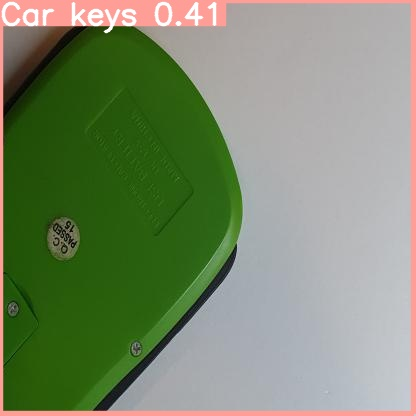

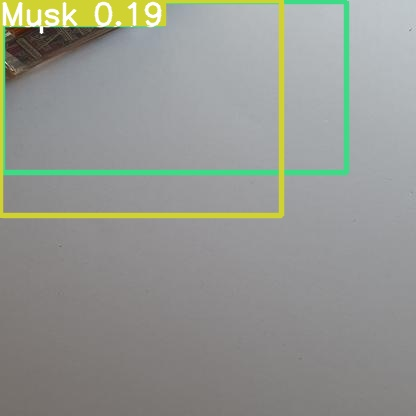

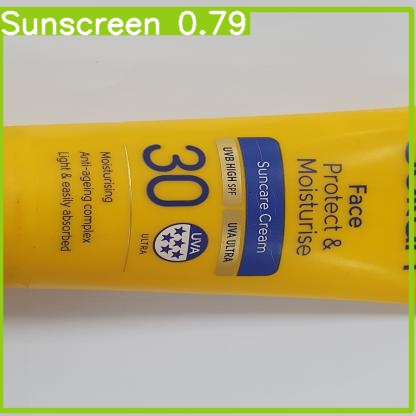

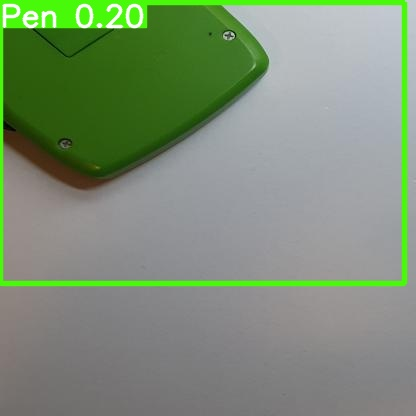

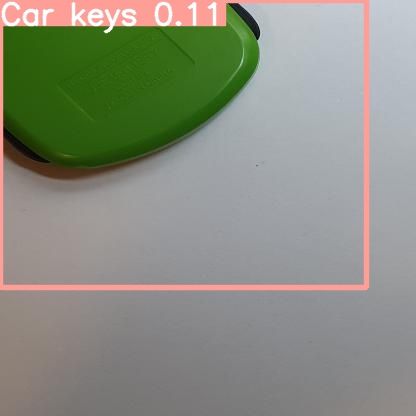

...

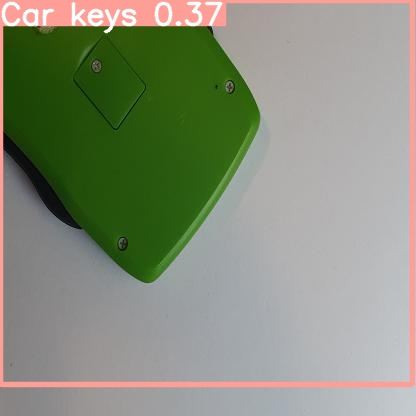

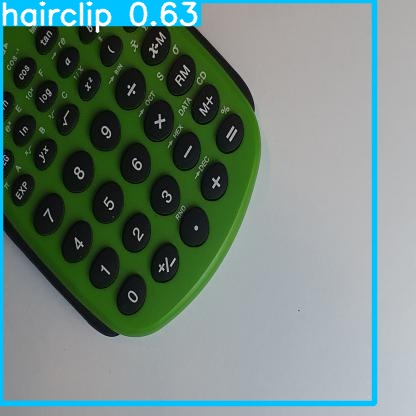

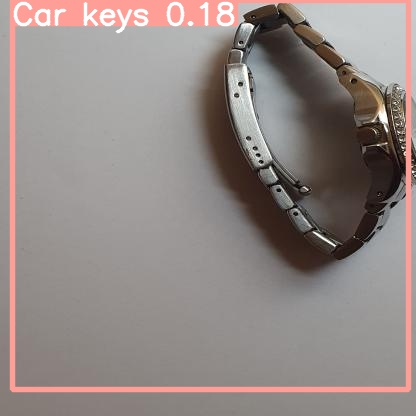

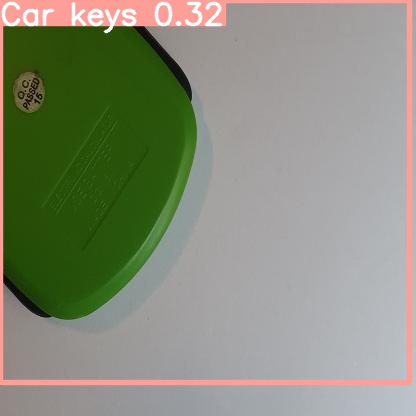

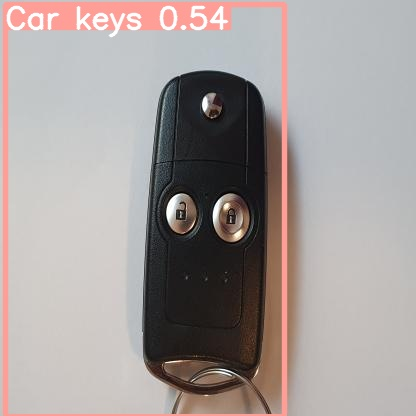

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/Video.mp4

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/Video.mp4, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-207-g5774a15 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7042489 parameters, 0 gradients, 15.9 GFLOPs
video 1/1 (1/1089) /content/Video.mp4: 256x416 Done. (0.022s)
video 1/1 (2/1089) /content/Video.mp4: 256x416 Done. (0.010s)
video 1/1 (3/1089) /content/Video.mp4: 256x416 Done. (0.009s)
video 1/1 (4/1089) /content/Video.mp4: 256x416 Done. (0.012s)
video 1/1 (5/1089) /content/Video.mp4: 256x416 Done. (0.010s)
video 1/1 (6/1089) /content/Video.mp4: 256x416 Done.

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/yolov5/runs/detect/exp4/Video.mp4"

# Compressed video path
compressed_path = "/content/Video-com.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/Vid.mp4

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/Vid.mp4, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-184-g9d8ed37 torch 1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7042489 parameters, 0 gradients, 15.9 GFLOPs
video 1/1 (1/1260) /content/Vid.mp4: 224x416 1 Musk, 1 Sunscreen, Done. (0.017s)
video 1/1 (2/1260) /content/Vid.mp4: 224x416 1 Musk, 1 Sunscreen, 1 Wallet, Done. (0.012s)
video 1/1 (3/1260) /content/Vid.mp4: 224x416 1 Musk, 1 Sunscreen, Done. (0.012s)
video 1/1 (4/1260) /content/Vid.mp4: 224x416 1 Musk, 1 Sunscreen, Done. (0.011s)
video 1/1 (5/1260) /content/Vid.mp4: 224x416

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/yolov5/runs/detect/exp4/Vid.mp4"

# Compressed video path
compressed_path = "/content/Vid-com.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)